In [1]:
import tensorflow as tf
import pickle
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter, FFMpegWriter
from matplotlib import rcParams
from datetime import datetime as dt

rnd_seed = 145
tf.random.set_seed(rnd_seed)

In [2]:


# ------------------------------------------------------------------
# 1. Load the SavedModel (includes the TextVectorization layer)
# ------------------------------------------------------------------
model_save_file = "../../gru_sentimento_6m__GRU_0801_chkp_sent_encoded_200_mzt_220_B32.keras"
model = tf.keras.models.load_model(model_save_file)

# ------------------------------------------------------------------
# 2. (Safety) Re-attach the *exact* vocabulary to the TextVectorization
# ------------------------------------------------------------------
vocab_file = "../../gru_sentimento_6m__GRU_0801_vocb_sent_encoded_200_mzt_220_B32.pkl"
with open(vocab_file, "rb") as f:
    vocab = pickle.load(f)

# Find the TextVectorization layer inside the loaded model
text_vec_layer = [l for l in model.layers if isinstance(l, tf.keras.layers.TextVectorization)][0]
text_vec_layer.set_vocabulary(vocab)

# ------------------------------------------------------------------
# 3. (Optional) Load metadata if you need the constants
# ------------------------------------------------------------------
metadata_file = "../../gru_sentimento_6m__GRU_0801_meta_sent_encoded_200_mzt_220_B32.pkl"
if os.path.exists(metadata_file):
    with open(metadata_file, "rb") as f:
        metadata = pickle.load(f)
    print("Metadata:", metadata)

print("Model ready for prediction!")


Metadata: {'token_count': 30000, 'embed_size': 128, 'num_classes': 3, 'saved_at': '2025-10-29T04:32:35.714609'}
Model ready for prediction!


In [3]:
# Get Data

input_data = pd.read_pickle('../dados/df_ata_sentimento_predict.pkl') 
#input_data = pd.read_json('../dados/df_ata_sentimento.json', orient='records', lines=True)
#input_data['Data'] = pd.to_datetime(input_data['Data']).dt.date
input_data['Texto'] = input_data['Texto'].str.lower()

print(input_data)
print(input_data.iloc[0,1][:100])

          Data                                              Texto  Selic  \
234 2025-05-07  a atualização da conjuntura econômica e do cen...  14.25   
235 2025-06-18  a atualização da conjuntura econômica e do cen...  14.75   
236 2025-07-30  a atualização da conjuntura econômica e do cen...  15.00   
237 2025-09-17  a atualização da conjuntura econômica e do cen...  15.00   

     IPCA  Selic (6m) Data (6m)  
234  5.32         NaN       NaT  
235  5.35         NaN       NaT  
236  5.23         NaN       NaT  
237  5.17         NaN       NaT  
a atualização da conjuntura econômica e do cenário do copom11 o ambiente externo mostrase adverso e 


In [4]:
#0 = dovish
#1 = hawkisk
#2 = neutral
#probs = model.predict(tf.constant([input_data.iloc[0,1]]))
sentiment_map = {0: 'dovish', 1: 'hawkisk', 2: 'neutral'}

probs = model.predict(tf.constant(input_data['Texto'].tolist()))
prediction = tf.argmax(probs, axis=1).numpy()
print(probs)
print(prediction)
input_data['Prediction'] = prediction
input_data['Prediction Text'] = input_data['Prediction'].map(sentiment_map)
print(input_data)




1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
[[9.9997252e-01 2.0214731e-05 7.2974567e-06]
 [9.9996394e-01 1.6479769e-05 1.9662908e-05]
 [9.9995834e-01 1.8023871e-05 2.3776018e-05]
 [9.9997705e-01 1.2211467e-05 1.0853659e-05]]
[0 0 0 0]
          Data                                              Texto  Selic  \
234 2025-05-07  a atualização da conjuntura econômica e do cen...  14.25   
235 2025-06-18  a atualização da conjuntura econômica e do cen...  14.75   
236 2025-07-30  a atualização da conjuntura econômica e do cen...  15.00   
237 2025-09-17  a atualização da conjuntura econômica e do cen...  15.00   

     IPCA  Selic (6m) Data (6m)  Prediction Prediction Text  
234  5.32         NaN       NaT           0          dovish  
235  5.35         NaN       NaT           0          dovish  
236  5.23         NaN       NaT           0          dovish  
237  5.17         NaN       NaT           0          dovish  


In [5]:
chart_data = pd.read_pickle('../dados/df_ata_sentimento.pkl') 

# A obtenção de dados da coluna Selic 6m dixa lacunas, limpar os dados:
#chart_data = chart_data.dropna(subset=['Selic (6m)','Texto'])
chart_data = chart_data.dropna(subset=['Texto'])

chart_data = chart_data[~(chart_data['Texto'].str.strip().isna() | (chart_data['Texto'].str.strip() == ''))]
chart_data['Texto'] = chart_data['Texto'].str.lower()

chart_data = chart_data.rename(columns={
    'Data': 'ref_date',
    'Texto': 'text',
    'Selic' : 'selic',
    'Selic (6m)' : 'selic_6m',
    'Data (6m)' : 'pred_date',
    'Sentimento': 'sentiment_true'
})


chart_data.drop(columns=['IPCA'], inplace=True)
sentiment_reverse_map = {'dovish' : 0 , 'hawkish' : 1,'neutral' : 2}
chart_data['y_true'] = chart_data['sentiment_true'].map(sentiment_reverse_map)


print(chart_data.head(5))
print(chart_data.sample(5))
print(chart_data.tail(5))



    ref_date                                               text  selic  \
0 1999-06-23  sumário preços e nível de atividade agregados ...   22.0   
1 1999-07-28  sumário preços e nível de atividade agregados ...   21.0   
2 1999-09-01  sumário demanda e oferta agregadas preços agre...   19.5   
3 1999-09-22  sumário demanda e oferta agregadas ambiente ex...   19.5   
4 1999-10-06  sumário demanda e oferta agregadas ambiente ex...   19.0   

   selic_6m  pred_date sentiment_true  y_true  
0      19.0 1999-10-06         dovish       0  
1      19.0 1999-11-10         dovish       0  
2      19.0 1999-12-15         dovish       0  
3      19.0 2000-01-19         dovish       0  
4      19.0 2000-02-16        neutral       2  
      ref_date                                               text  selic  \
33  2002-03-20  sumário atividade econômica ambiente externo p...  18.75   
64  2004-09-15  sumário evolução recente da inflação avaliação...  16.00   
139 2013-05-29  sumário evolução recent

In [6]:
#0 = dovish
#1 = hawkisk
#2 = neutral
#probs = model.predict(tf.constant([input_data.iloc[0,1]]))
sentiment_map = {0: 'dovish', 1: 'hawkisk', 2: 'neutral'}

probs = model.predict(tf.constant(chart_data['text'].tolist()))
prediction = tf.argmax(probs, axis=1).numpy()
#print(probs)
#print(prediction)
chart_data['y_pred'] = prediction
chart_data['sentiment_pred'] = chart_data['y_pred'].map(sentiment_map)
print(chart_data.head(5))
print(chart_data.sample(5))
print(chart_data.tail(5))

7/7 ━━━━━━━━━━━━━━━━━━━━ 5s 711ms/step
    ref_date                                               text  selic  \
0 1999-06-23  sumário preços e nível de atividade agregados ...   22.0   
1 1999-07-28  sumário preços e nível de atividade agregados ...   21.0   
2 1999-09-01  sumário demanda e oferta agregadas preços agre...   19.5   
3 1999-09-22  sumário demanda e oferta agregadas ambiente ex...   19.5   
4 1999-10-06  sumário demanda e oferta agregadas ambiente ex...   19.0   

   selic_6m  pred_date sentiment_true  y_true  y_pred sentiment_pred  
0      19.0 1999-10-06         dovish       0       0         dovish  
1      19.0 1999-11-10         dovish       0       0         dovish  
2      19.0 1999-12-15         dovish       0       0         dovish  
3      19.0 2000-01-19         dovish       0       0         dovish  
4      19.0 2000-02-16        neutral       2       2        neutral  
      ref_date                                               text  selic  \
214 2022-10-26

In [7]:
selic_data = chart_data[['ref_date', 'selic']].copy()
label_data = chart_data[['ref_date','pred_date', 'selic','y_pred']].copy()

print(selic_data.tail(5))
print(label_data.tail(15))
##### Plotar na pred_date, no valor da selic original, apontando a tendencia
len(chart_data)

      ref_date  selic
233 2025-03-19  13.25
234 2025-05-07  14.25
235 2025-06-18  14.75
236 2025-07-30  15.00
237 2025-09-17  15.00
      ref_date  pred_date  selic  y_pred
223 2023-12-13 2024-06-19  12.25       0
224 2024-01-31 2024-07-31  11.75       0
225 2024-03-20 2024-09-18  11.25       0
226 2024-05-08 2024-11-06  10.75       2
227 2024-06-19 2024-12-11  10.50       1
228 2024-07-31 2025-01-29  10.50       1
229 2024-09-18 2025-03-19  10.50       1
230 2024-11-06 2025-05-07  10.75       1
231 2024-12-11 2025-06-18  11.25       1
232 2025-01-29 2025-07-30  12.25       1
233 2025-03-19 2025-09-17  13.25       1
234 2025-05-07        NaT  14.25       0
235 2025-06-18        NaT  14.75       0
236 2025-07-30        NaT  15.00       0
237 2025-09-17        NaT  15.00       0


206

      ref_date  pred_date  selic  y_pred marker      month
48  2003-05-21 2003-09-17  26.50       0      D 2003-09-01
231 2024-12-11 2025-06-18  11.25       1      s 2025-06-01
10  2000-04-19 2000-08-23  18.50       0      D 2000-08-01
105 2009-03-11 2009-09-02  12.75       0      D 2009-09-01
133 2012-08-29 2013-03-06   8.00       0      D 2013-03-01


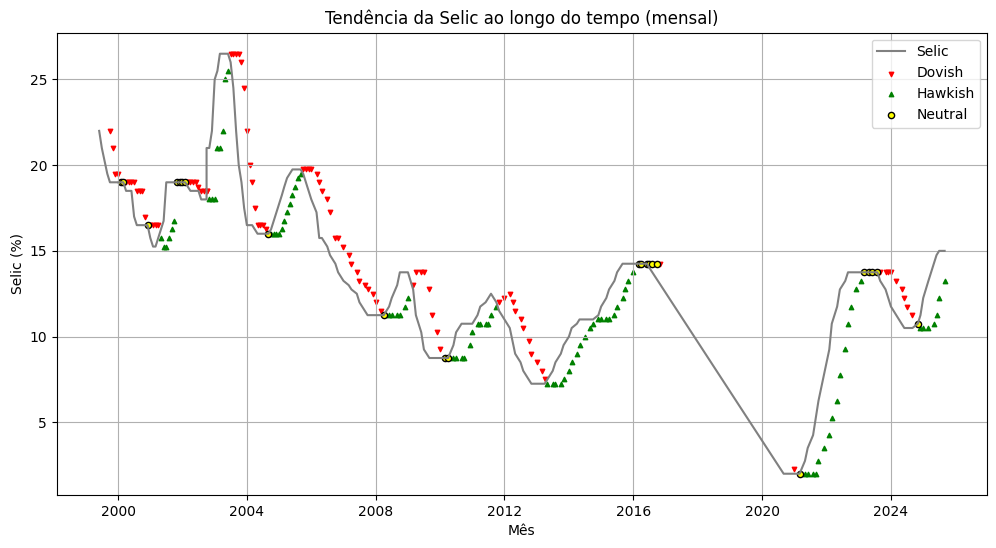

In [8]:
# '^'
# 'v'
#'.'
#'>'



marker_map = {0: 'D', 1: 's', 2: 'o'}
color_map = {0: 'red', 1: 'gree', 2: 'yellow'}
label_data['marker'] = label_data['y_pred'].map(marker_map)



markers = 'o'


selic_data['selic'] = pd.to_numeric(selic_data['selic'], errors='coerce')
selic_data['month'] = selic_data['ref_date'].dt.to_period('M').dt.to_timestamp()

label_data['selic'] = pd.to_numeric(label_data['selic'], errors='coerce')
label_data['month'] = label_data['pred_date'].dt.to_period('M').dt.to_timestamp()

print(label_data.sample(5))

dovish_data = label_data[label_data['y_pred']==0]
hawkish_data = label_data[label_data['y_pred']==1]
neutral_data = label_data[label_data['y_pred']==2]

plt.figure(figsize=(12, 6))
plt.plot(selic_data['month'], selic_data['selic'], label='Selic', color='gray')
plt.scatter(dovish_data['month'], dovish_data['selic'], label='Dovish', color='red',marker = 'v', s=10)
plt.scatter(hawkish_data['month'], hawkish_data['selic'], label='Hawkish', color='green',marker = '^', s=10)
plt.scatter(neutral_data['month'], neutral_data['selic'], label='Neutral', color='yellow',marker = 'o', s=20,edgecolor='k')
plt.xlabel('Mês')
plt.ylabel('Selic (%)')
plt.title('Tendência da Selic ao longo do tempo (mensal)')
plt.legend()
plt.grid(True)
plt.show()


In [23]:
#Limit time



start_date = dt.strptime('2000-01-01', "%Y-%m-%d")
end_date = dt.strptime('2004-12-31', "%Y-%m-%d")

#start_date = dt.strptime('2022-01-01', "%Y-%m-%d")
#end_date = dt.strptime('2025-12-31', "%Y-%m-%d")

label_data = label_data[(label_data['ref_date']>= start_date)&(label_data['ref_date']<= end_date)]

selic_data = selic_data[(selic_data['ref_date']>= start_date)&(selic_data['ref_date']<= end_date)]

Frame 609: line_x length = 610, line_y length = 610


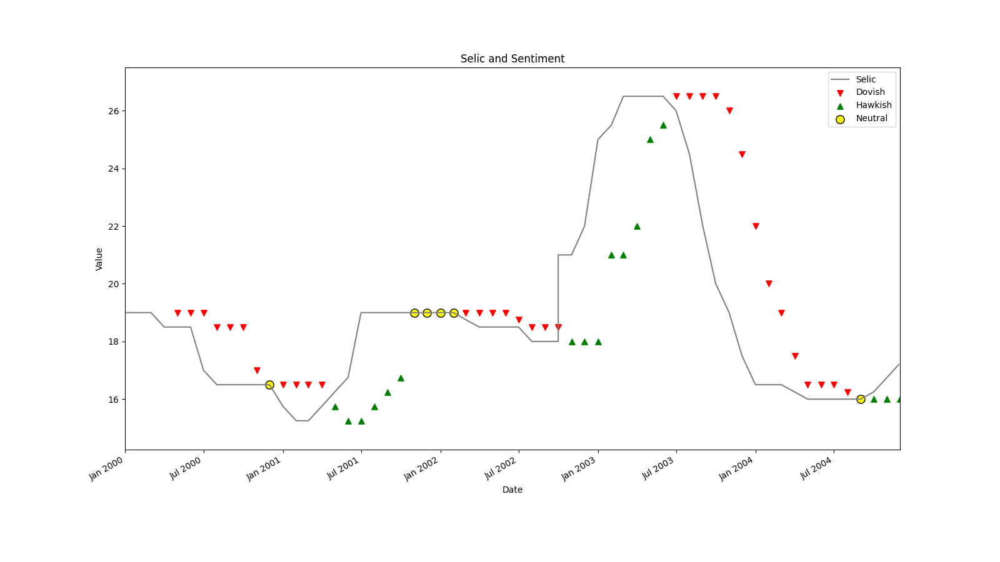

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib.dates as mdates
from matplotlib.animation import PillowWriter
from IPython.display import HTML
%matplotlib ipympl
import numpy as np

from IPython.display import clear_output

# 1. Prepare your Data (unchanged, assuming data is correct)
# Assuming 'selic_data' and 'label_data' are DataFrames with 'month' (datetime) and 'selic' columns
label_data['month_num'] = mdates.date2num(label_data['month'])
dovish_data = label_data.copy()
dovish_data.loc[dovish_data['y_pred'] != 0, 'selic'] = -10
hawkish_data = label_data.copy()
hawkish_data.loc[hawkish_data['y_pred'] != 1, 'selic'] = -10
neutral_data = label_data.copy()
neutral_data.loc[neutral_data['y_pred'] != 2, 'selic'] = -10

# 2. Set up the Matplotlib Figure and Axes
fig, ax = plt.subplots(figsize=(16, 9))
# Initialize line with no data
line, = ax.plot([], [], color='grey', label='Selic')
scatter_d = ax.scatter([], [], label='Dovish', color='red', marker='v', s=45)
scatter_h = ax.scatter([], [], label='Hawkish', color='green', marker='^', s=45)
scatter_n = ax.scatter([], [], label='Neutral', color='yellow', marker='o', s=90, edgecolor='k')
ax.legend()
ax.set_xlabel("Date")
ax.set_ylabel("Value")
ax.set_title("Selic and Sentiment")
# Format date ticks
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
fig.autofmt_xdate()
# Set axis limits
ax.set_xlim(selic_data['month'].min(), selic_data['month'].max())
ax.set_ylim(selic_data['selic'].min()-1, selic_data['selic'].max()+1)

# 3. Define Initialization Function
def init():
    """Initialize the plot with empty data."""
    line.set_data([], [])
    scatter_d.set_offsets(np.empty((0, 2)))
    scatter_h.set_offsets(np.empty((0, 2)))
    scatter_n.set_offsets(np.empty((0, 2)))
    return line, scatter_d, scatter_h, scatter_n

# 4. Define the Animation Function
# ... (Data preparation and plot setup same as above)

# ... (Data preparation and plot setup same as above)

# Initialize line data
line_x = []
line_y = []

def init():
    global line_x, line_y
    line_x = []
    line_y = []
    line.set_data([], [])
    scatter_d.set_offsets(np.empty((0, 2)))
    scatter_h.set_offsets(np.empty((0, 2)))
    scatter_n.set_offsets(np.empty((0, 2)))

    #clear_output(wait=True)
    print("Initialized: line_x length =", len(line_x), "line_y length =", len(line_y),end='\r')

    return line, scatter_d, scatter_h, scatter_n

def animate(i):
    global line_x, line_y
    sub_frames = 10  # Sub-frames per data point
    data_idx = i // sub_frames
    frac = (i % sub_frames) / sub_frames
    
    if i == 0:
        line_x = []
        line_y = []
    
    if data_idx >= len(selic_data):
        return line, scatter_d, scatter_h, scatter_n
    
    if data_idx == 0 and frac == 0:
        current_selic = selic_data.iloc[0]
        line_x.append(current_selic['month'])
        line_y.append(current_selic['selic'])
    else:
        prev_selic = selic_data.iloc[max(0, data_idx-1)]
        curr_selic = selic_data.iloc[min(data_idx, len(selic_data)-1)]
        interp_x = prev_selic['month'] + frac * (curr_selic['month'] - prev_selic['month'])
        interp_y = prev_selic['selic'] + frac * (curr_selic['selic'] - prev_selic['selic'])
        line_x.append(interp_x)
        line_y.append(interp_y)
    
    # Debug shapes
    clear_output(wait=True)
    print(f"Frame {i}: line_x length = {len(line_x)}, line_y length = {len(line_y)}")
    if len(line_x) != len(line_y):
        raise ValueError(f"Shape mismatch: line_x has {len(line_x)} elements, line_y has {len(line_y)} elements")
    
    line.set_data(line_x, line_y)
    
    if frac == 0:
        current_dovish = dovish_data.iloc[:data_idx+1]
        offsets_d = np.column_stack((current_dovish['month_num'], current_dovish['selic']))
        scatter_d.set_offsets(offsets_d)
        current_hawkish = hawkish_data.iloc[:data_idx+1]
        offsets_h = np.column_stack((current_hawkish['month_num'], current_hawkish['selic']))
        scatter_h.set_offsets(offsets_h)
        current_neutral = neutral_data.iloc[:data_idx+1]
        offsets_n = np.column_stack((current_neutral['month_num'], current_neutral['selic']))
        scatter_n.set_offsets(offsets_n)
    
    return line, scatter_d, scatter_h, scatter_n

ani = animation.FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=len(selic_data) * 10,
    interval=50,
    blit=True,
    repeat=False
)

ani.save('animated_sentiment_chart.gif', writer=PillowWriter(fps=24))
ani.save('animated_sentiment_chart.mp4', writer='ffmpeg', fps=24)
HTML(ani.to_jshtml())